# Approximate Dynamic Programming

In [2]:
using Interact
import PGFPlots
using Distributions
include("helpers.jl");

## Function Approximation

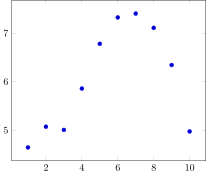

In [3]:
# Generate some random data
using Random
Random.seed!(0)
s = 1:10
u = 4 .- 0.5 * s .+ 0.35 * s.^2 .- 0.03 * s.^3 .+ rand(length(s))
PGFPlots.Plots.Scatter(s, u)

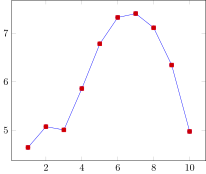

In [4]:
PGFPlots.Axis([
        PGFPlots.Plots.Linear(s, u),
        PGFPlots.Plots.Scatter(s, u)
    ])

In [5]:
using LinearAlgebra
function polyfitFunction(X, Y, order)
    λ = polyfit(X, Y, order) # polyfit in helpers.jl
    β(x) = [float(x)^p for p = 0:order]
    (x) -> LinearAlgebra.dot(λ, β(x))
end;

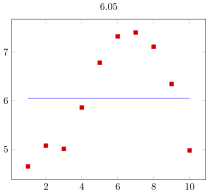

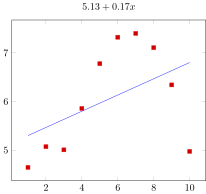

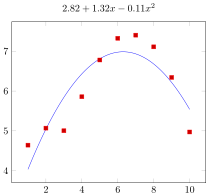

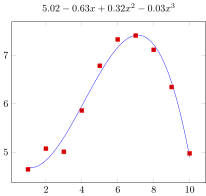

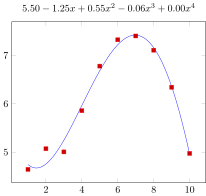

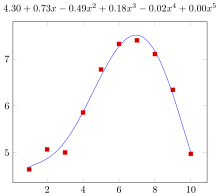

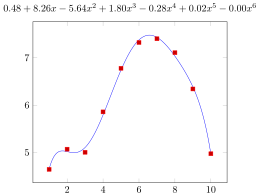

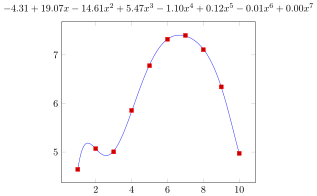

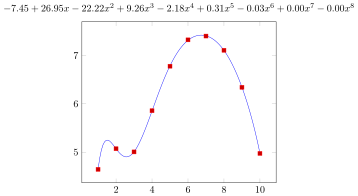

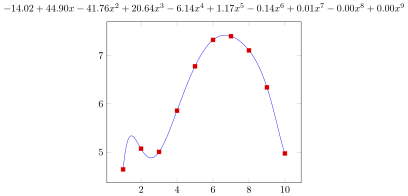

In [6]:
for order in 0:9
    title=prettyPolynomial(polyfit(s, u, order))
    ax = PGFPlots.Axis([
        PGFPlots.Plots.Linear(polyfitFunction(s, u, order), (1,10)),
        PGFPlots.Plots.Scatter(s, u),
        ], title=title)
    display(ax)
end    

## Cross Entropy Method

In [ ]:
# Example true function (has local optima)
V(λ) = 0.5*(exp(-(λ/2).^2) + 2 * exp(-((λ - 10)/2).^2) + 0.75 * exp(-((λ - 5)/2).^2));

In [ ]:
# Note: this is designed for univariate functions (easy to generalize, though)
function crossEntropyMethod(f::Function, distribution; steps = 10, populationSize = 20, eliteSize = 5)
    while true
        # draw population of random samples from the distribution
        samples = rand(distribution, populationSize)
        # get the indices of the samples in decreasing order
        index = sortperm(map(f, samples), rev=true)
        # pull off the elite samples
        eliteSamples = samples[index[1:eliteSize]]
        if steps == 0
            return samples, eliteSamples, distribution
        else
            steps = steps - 1
        end
        # update the distribution based on the elite samples
        distribution = fit_mle(Normal, eliteSamples)
    end
end;

In [ ]:
initialDistribution = Normal(0, 1)
domain = (-15,15)
@manipulate for steps = 0:4
    Random.seed!(0)
    (samples, eliteSamples, distribution) = crossEntropyMethod(λ->V(λ), Normal(0., 10.), steps = steps)
    densityScale = 1/pdf(distribution, distribution.μ)
    density = λ->densityScale*pdf(distribution, λ)
    PGFPlots.Axis([
        PGFPlots.Plots.Linear(V, domain),
        PGFPlots.Plots.Scatter(samples, map(V, samples), mark="+"),
        PGFPlots.Plots.Scatter(eliteSamples, map(V, eliteSamples)),
        PGFPlots.Plots.Linear(density, domain)
        ], xmin=domain[1], xmax=domain[2], ymin=0
    )
end

# Function Approximation Value Iteration

In [7]:
using ContinuumWorld
using POMDPs
using Interact
using GridInterpolations
using Plots
gr()

Plots.GRBackend()

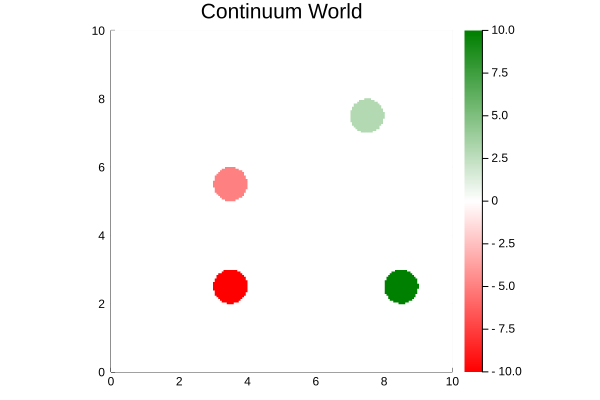

In [8]:
w = CWorld()

dummy_s = Vec2(0.0, 0.0)
dummy_a = Vec2(0.0, 0.0)
plot(CWorldVis(w, f=sp->reward(w,dummy_s,dummy_a,sp)))

In [9]:
nx = 30
ny = 30
grid = RectangleGrid(range(w.xlim[1], stop=w.xlim[2], length=nx), range(w.ylim[1], stop=w.ylim[2], length=ny))

sol = CWorldSolver(max_iters=30, m=50, grid=grid)

@time policy = solve(sol, w);

finished iteration 30
extracting policy...     done.
 10.429385 seconds (44.00 M allocations: 23.910 GiB, 16.58% gc time)


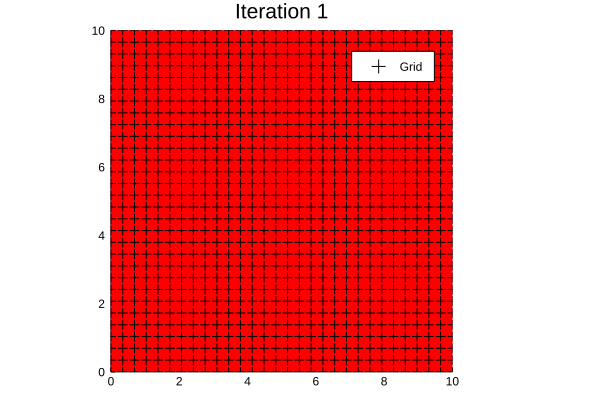

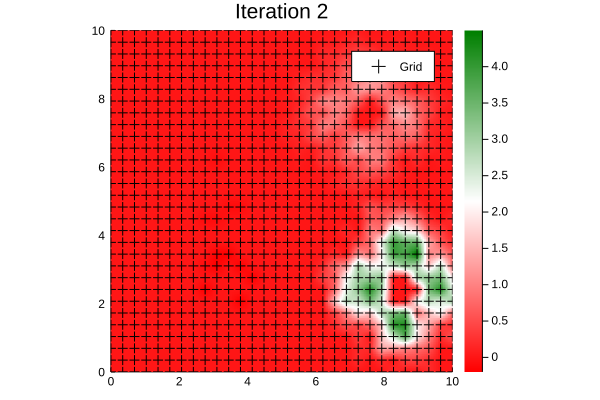

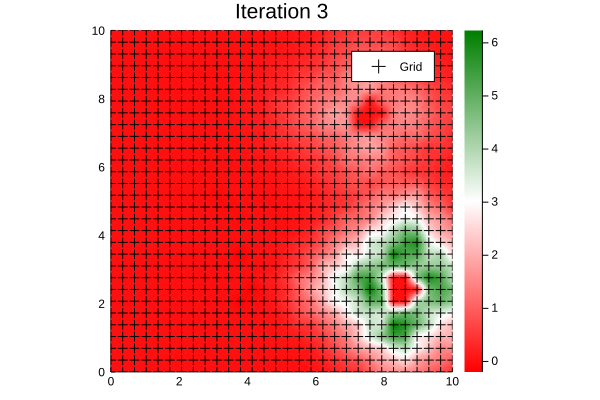

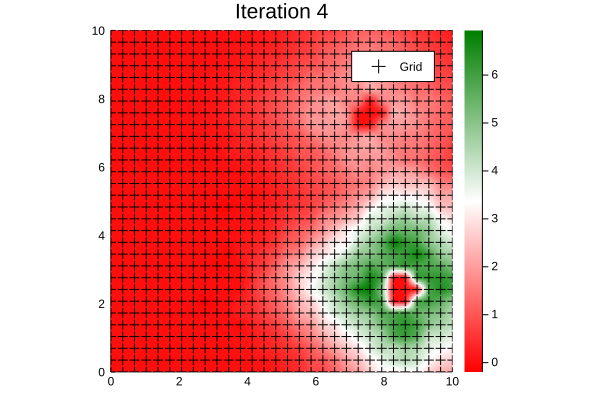

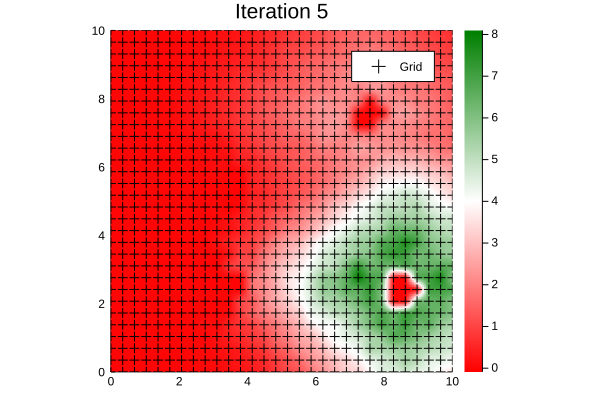

...

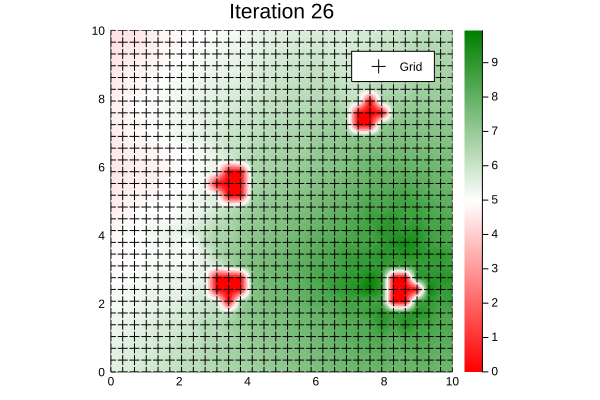

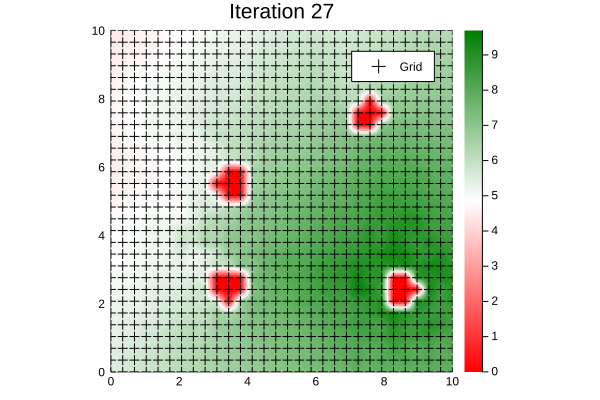

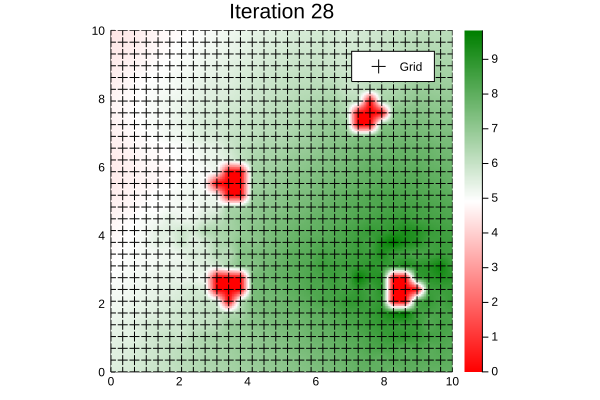

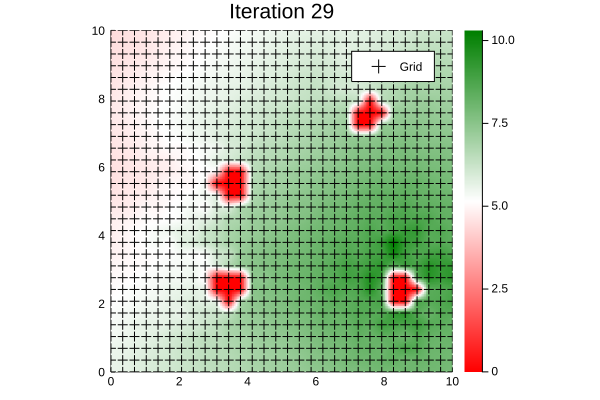

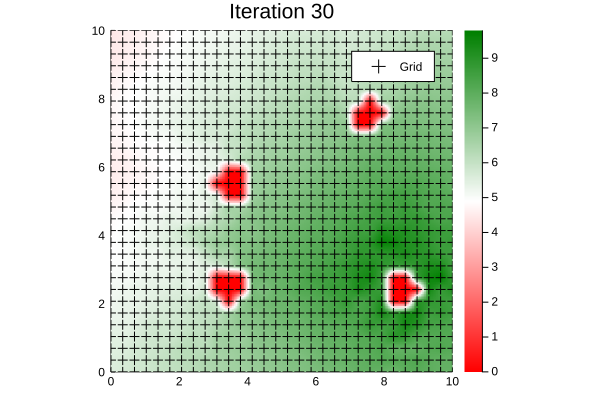

GKS: Rectangle definition is invalid in routine SET_WINDOW
GKS: Rectangle definition is invalid in routine CELLARRAY
invalid range


In [10]:
for i in 1:length(sol.value_hist)
    v = sol.value_hist[i]
    t = "Iteration $i"
    p = plot(CWorldVis(w, f=s->evaluate(v, s),
            g=sol.grid,
            title=t))
    display(p)
end

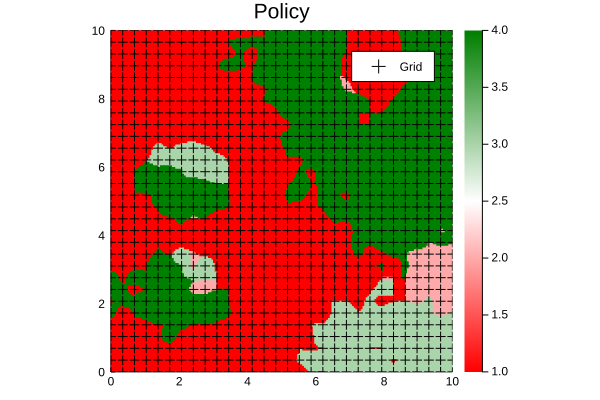

In [11]:
plot(CWorldVis(w, f=s->action_ind(policy, s), g=sol.grid, title="Policy"))